# Setup

In [ ]:
!pip install --upgrade bertopic
!pip install -U plotly==5.19.0

In [1]:
import pandas as pd
import gensim
import re
import os

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/williamniemiec/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     /home/williamniemiec/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     /home/williamniemiec/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


In [ ]:
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('punkt_tab')
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
from nltk.tokenize import word_tokenize

# Corpus load

In [5]:
corpus = []

os.chdir('../data/1. nic_to_nbc')

# iterate through all file
for file in os.listdir():
    # Check whether file is in text format or not
    if file.endswith(".txt"):
        # call read text file function
        with open(file, 'r') as f:
          corpus.append(f.read())

os.chdir("../../scripts")

## Preprocessing

In [ ]:
def preprocess_text(text,remove_stopwords=True, stem=False):
  extracted_json = re.search(r'(\{\n[\s\S\n]+\}\n)', text)
  
  if extracted_json:
    extracted_json = extracted_json.group(1)
  else:
    extracted_json = ""
    
  words = extracted_json.lower().split()

  if remove_stopwords:
    stops = set(stopwords.words('english'))
    words = [w for w in words if w not in stops]
      
  sentence = " ".join(words)
  sentence = re.sub(r"[^A-Za-z(),!.?\'\`]", " ", sentence)
  sentence = re.sub(r",", " ", sentence)
  sentence = re.sub(r"\.", " ", sentence)
  sentence = re.sub(r"!", " ", sentence)
  sentence = re.sub(r"\(", " ( ", sentence)
  sentence = re.sub(r"\)", " ) ", sentence)
  sentence = re.sub(r"\?", " ", sentence)
  sentence = re.sub(r"\s{2,}", " ", sentence)
  sentence = re.sub("media ", " multimedia ", sentence)
  sentence = re.sub("http", " multimedia ", sentence)
  sentence = re.sub("https", " multimedia ", sentence)
  sentence = re.sub("videos", " multimedia ", sentence)
  sentence = re.sub("video", " multimedia ", sentence)
  sentence = re.sub("url", " multimedia ", sentence)
  sentence = re.sub("image", " multimedia ", sentence)
  sentence = re.sub("images", " multimedia ", sentence)
  sentence = re.sub("html", " multimedia ", sentence)
  sentence = re.sub("site", " multimedia ", sentence)
  sentence = re.sub("sites", " multimedia ", sentence)
  sentence = re.sub("link", " multimedia ", sentence)
  sentence = re.sub("links", " multimedia ", sentence)
  sentence = re.sub("log", " registry ", sentence)
  sentence = re.sub("logger", " registry ", sentence)
  sentence = re.sub("logging", " registry ", sentence)
  sentence = re.sub("no", " boolean ", sentence)
  sentence = re.sub("yes", " boolean ", sentence)
  sentence = re.sub("not", " boolean ", sentence)
  
  # words from computer science's domain
  remove_words = [
    "no-code",
    "code",
    "element",
    "name",
    "parameter",
    "parameters",
    "especification",
    "specification",
    "especifications",
    "specifications",
    "coding",
    "boolean",
    "none",
    "null",
  ]
  
  for w in remove_words:
    sentence = re.sub("(([\\s\\\"\\`\\']+" + w + ")+)|((" + w + "[\\s\\\"\\`\\']+)+)", "  ", sentence)

  if stem:
    words = sentence.split()
    stemmer = SnowballStemmer('english')
    stemmed_words = [stemmer.stem(word) for word in words]
    return " ".join(stemmed_words)
  return sentence

In [6]:
documents = []
parsed_corpus = []
selected_corpus_indexes = []

for i in range(len(corpus)):
  text = corpus[i]
  parsed_text = preprocess_text(text,True,False)
  documents.append(parsed_text)
    
  if len(parsed_text) > 0:
      parsed_corpus.append(text)
      selected_corpus_indexes.append(i)

## Remove empty documents

In [7]:
empty_documents = [d for d in documents if len(d) == 0]
documents = [d for d in documents if len(d) > 0]

In [8]:
print('Empty docs: ', len(empty_documents)

2003

## Embeddings

### Doc2Vec

In [8]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
tagged_documents = [TaggedDocument(words=word_tokenize(_d.lower()), tags=[str(i)]) for i, _d in enumerate(documents)]

In [9]:
def train_and_save(force_train=False,saved_model_name="d2v.model"):
  if os.path.exists(saved_model_name) and not force_train:
    return
  max_epochs = 10
  vec_size = 100
  alpha = 0.025

  model = Doc2Vec(vector_size=vec_size,
                  alpha=alpha,
                  min_alpha=0.00025,
                  min_count=1,
                  dm =1)

  model.build_vocab(tagged_documents)

  for epoch in range(max_epochs):
      print('iteration {0}'.format(epoch))
      model.train(tagged_documents,
                  total_examples=model.corpus_count,
                  epochs=model.epochs)
      # decrease the learning rate
      model.alpha -= 0.0002
      # fix the learning rate, no decay
      model.min_alpha = model.alpha

  model.save("saved_model_name")
  print("Model Saved")
  return model

raw_model = train_and_save()
model = raw_model.wv

iteration 0
iteration 1
iteration 2
iteration 3
iteration 4
iteration 5
iteration 6
iteration 7
iteration 8
iteration 9
Model Saved


### Loads embeddings using an SBERT model

In [16]:
from sentence_transformers import SentenceTransformer

sentence_model = SentenceTransformer("all-mpnet-base-v2", device="cuda")
embeddings = sentence_model.encode(documents, device='cuda', show_progress_bar=True)

Batches:   0%|          | 0/346 [00:00<?, ?it/s]

In [17]:
from bertopic import BERTopic
from hdbscan import HDBSCAN

cluster_model = HDBSCAN(min_cluster_size=10, cluster_selection_method='eom', prediction_data=True)
topic_model = BERTopic(hdbscan_model=cluster_model).fit(documents, embeddings=embeddings)

# Results

## Word embeeding - Dimensionality reduction

In [31]:
from umap import UMAP

reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine', random_state = 42).fit_transform(embeddings)

## Data visualization

### Documents and Topics - with reduced embeddings

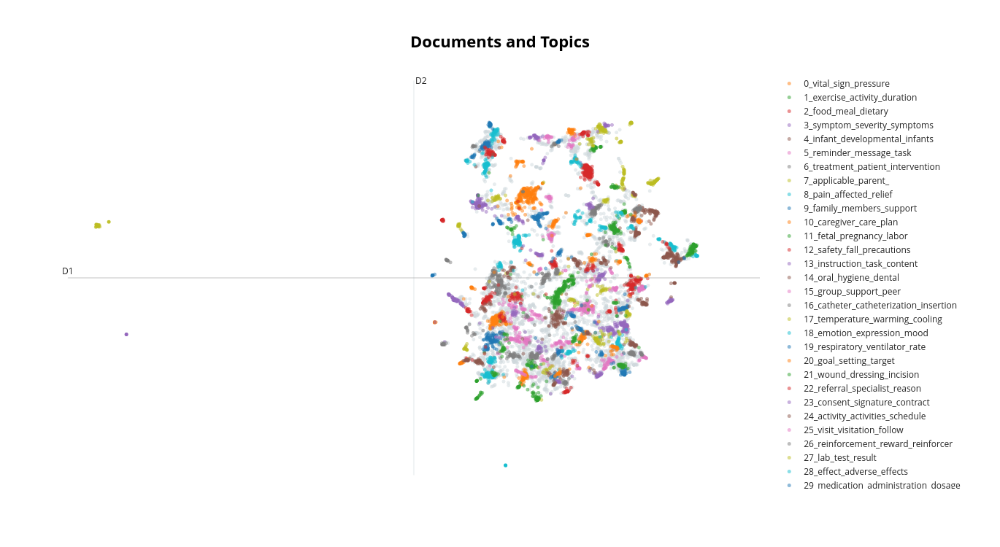

In [32]:
topic_model.visualize_documents(documents, reduced_embeddings=reduced_embeddings, hide_annotations=True)

### Documents and Topics - without reduced embeddings

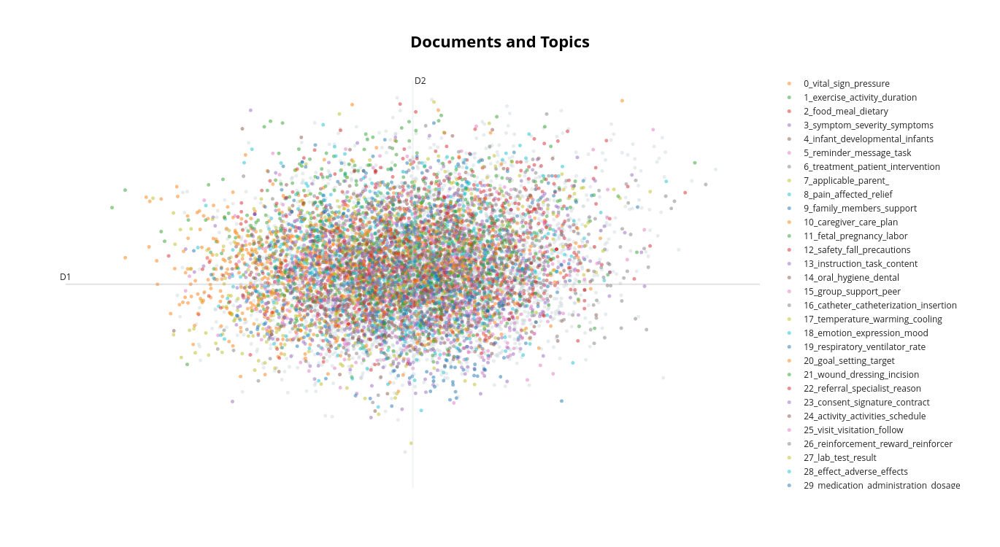

In [33]:
topic_model.visualize_documents(documents, reduced_embeddings=embeddings, hide_annotations=True)

### Topics with top 8 most representative words

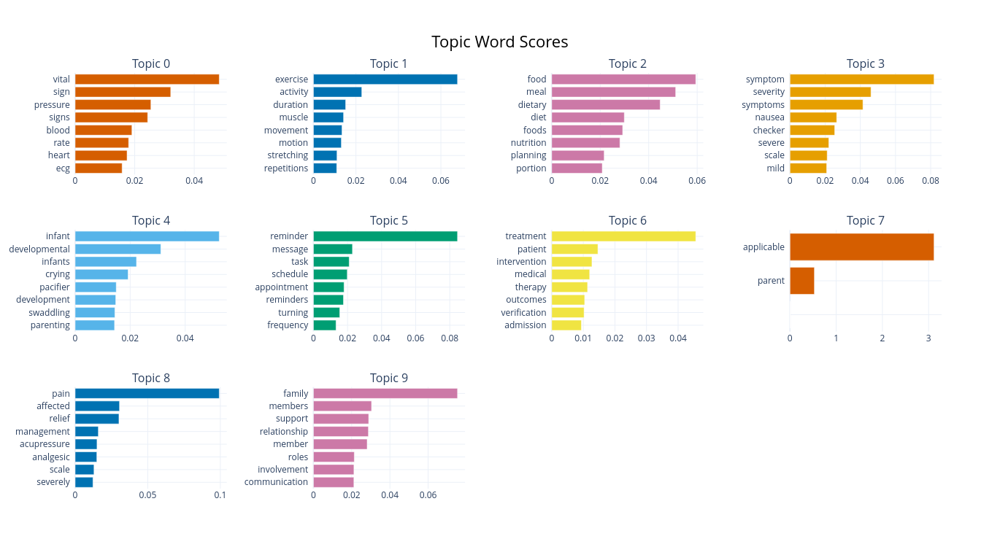

None

In [36]:
display(topic_model.visualize_barchart(top_n_topics=10, n_words=8).show())

### Topics with top 8 most representative words

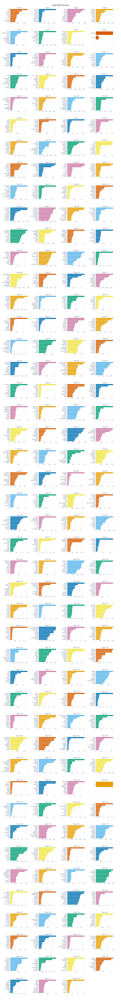

None

In [37]:
display(topic_model.visualize_barchart(top_n_topics=len(topicos.keys()), n_words=10).show())

### Hierarchical clustering

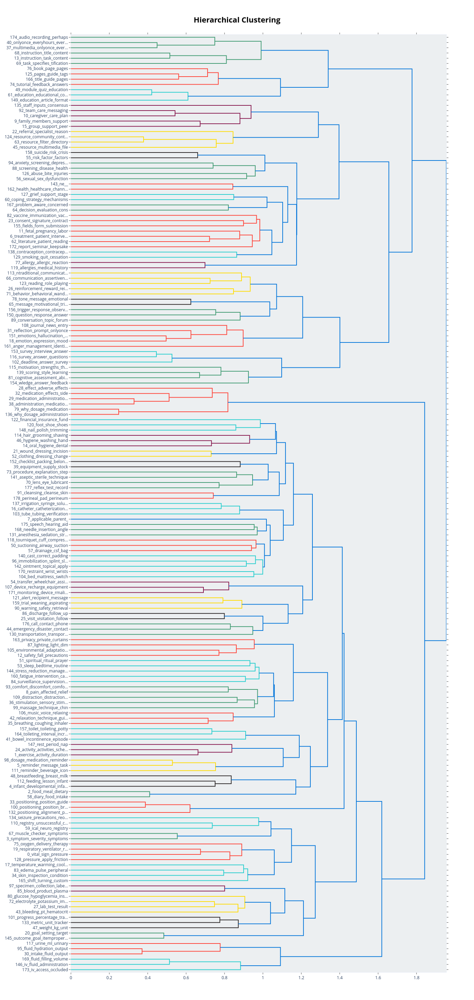

In [38]:
topic_model.visualize_hierarchy() # o parâmetro 'top_n_topics' restringe o numero de tópicos para casos onde bão limita o número de tópicos

### Heatmap - topics similarity

In [39]:
topic_model.visualize_heatmap(n_clusters=len(topic_model.get_topics().keys())-2, width=800, height=800)

# Evaluation

In [41]:
import gensim.corpora as corpora
from gensim.models.coherencemodel import CoherenceModel
# https://radimrehurek.com/gensim/models/coherencemodel.html

> If the goal is to have well-interpretable topics, coherence score may be more important as it ensures that the words within a topic are semantically coherent. On the other hand, if the goal is to cover a wide range of diverse topics, topic diversity becomes more important as it ensures that the topics are distinct from each other.

## Coherence

In [42]:
def coherence_score(docs, topic_model,coherence_type='c_v'):
    # https://github.com/MaartenGr/BERTopic/issues/90#issuecomment-1455027341
    # Preprocess Documents
    topics = topic_model.topics_
    documents = pd.DataFrame({"Document": docs,
                            "ID": range(len(docs)),
                            "Topic": topics})
    documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
    cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

    # Extract vectorizer and analyzer from BERTopic
    vectorizer = topic_model.vectorizer_model
    analyzer = vectorizer.build_analyzer()

    # Use .get_feature_names_out() if you get an error with .get_feature_names()
    words = vectorizer.get_feature_names_out()

    # Extract features for Topic Coherence evaluation
    tokens = [analyzer(doc) for doc in cleaned_docs]
    dictionary = corpora.Dictionary(tokens)
    corpus = [dictionary.doc2bow(token) for token in tokens]

    # Extract words in each topic if they are non-empty and exist in the dictionary
    topic_words = []
    for topic in range(len(set(topics))-topic_model._outliers):
        words = list(zip(*topic_model.get_topic(topic)))[0]
        words = [word for word in words if word in dictionary.token2id]
        topic_words.append(words)
    topic_words = [words for words in topic_words if len(words) > 0]

    # Evaluate Coherence
    coherence_model = CoherenceModel(topics=topic_words,
                                    texts=tokens,
                                    corpus=corpus,
                                    dictionary=dictionary,
                                    coherence=coherence_type)
    coherence = coherence_model.get_coherence()
    return coherence

In [43]:
c = coherence_score(documents, topic_model)
print(f"{c:.4f}")

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

0.6496


## Diversity

In [46]:
from scipy.spatial import distance
from itertools import combinations

def proportion_unique_words(topics, topk=10):
    """
    compute the proportion of unique words

    Parameters
    ----------
    topics: a list of lists of words
    topk: top k words on which the topic diversity will be computed
    """
    if topk > len(topics[0]):
        raise Exception('Words in topics are less than '+str(topk))
    else:
        unique_words = set()
        for topic in topics:
            unique_words = unique_words.union(set(topic[:topk]))
        puw = len(unique_words) / (topk * len(topics))
        return puw


def pairwise_jaccard_diversity(topics, topk=10):
    '''
    compute the average pairwise jaccard distance between the topics

    Parameters
    ----------
    topics: a list of lists of words
    topk: top k words on which the topic diversity
          will be computed

    Returns
    -------
    pjd: average pairwise jaccard distance
    '''
    dist = 0
    count = 0
    for list1, list2 in combinations(topics, 2):
        js = 1 - len(set(list1).intersection(set(list2)))/len(set(list1).union(set(list2)))
        dist = dist + js
        count = count + 1
    return dist/count

In [48]:
df3 = topic_model.get_topic_info()
topics_lists = list(df3['Representation'])

In [49]:
print("puw:",proportion_unique_words(topics_lists, topk=10))
print("jd:", pairwise_jaccard_diversity(topics_lists, topk=10))

puw: 0.6722222222222223
jd: 0.995751203406691


# Export topics to CSV

In [ ]:
# Get the top words for each topic
topics = topic_model.get_topics()

# Create a list of dictionaries
topic_data = [
    {"Topic": f"Topic {topic}", "Words": ", ".join([word for word, _ in words])}
    for topic, words in topics.items() if topic != -1  # Exclude outliers (-1)
]

# Convert list of dictionaries to a DataFrame
df = pd.DataFrame(topic_data)

# Exports to CSV
df.to_csv("topics_words.csv", index=False)

In [76]:
df

,Topic,Words
0,Topic 0,"vital, sign, pressure, signs, blood, rate, hea..."
1,Topic 1,"exercise, activity, duration, muscle, movement..."
2,Topic 2,"food, meal, dietary, diet, foods, nutrition, p..."
3,Topic 3,"symptom, severity, symptoms, nausea, checker, ..."
4,Topic 4,"infant, developmental, infants, crying, pacifi..."
...,...,...
174,Topic 174,"audio, recording, perhaps, ry, wish, script, m..."
175,Topic 175,"speech, hearing, aid, vocal, processes, audio,..."
176,Topic 176,"call, contact, phone, delegate, adapted, switc..."
177,Topic 177,"reflex, test, record, please, by, step, second..."
